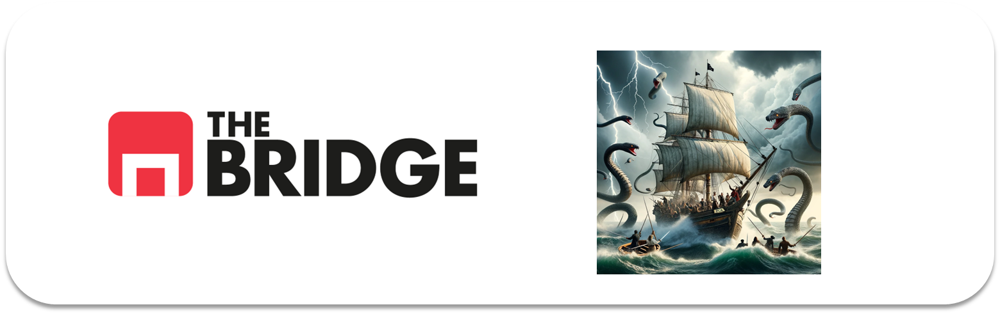

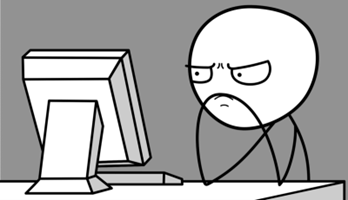

Para ejercitarte y afianzar lo aprendido sobre **Seleccion de Features**, completa los siguientes ejercicios. Recuerda que necesitarás datos que están en el directorio data que acompaña al notebook (búscalo en el repositorio de ejercicios)
  
La solución a los mismos las tienes ya, intenta no mirarlos de primeras pero no dejes de hacerlo cuando hayas terminado por si te pudieran aportar.

## Feature selection: Breast Cancer Winsconsin

El objetivo de este grupo de ejercicio es dar a entender la importancia de la selección de características (features), así como probar distintos métodos de reducción de características (features) y qué influencia puede tener el reducir features en el perfomance de un modelo. Nuestro target para evaluar el perfomance será si estamos ante tumores malignos o benignos.

Vamos a trabajar con el dataset de Breast Cancer Winsconsin, datos tomados a partir de radiografías.

### Ejercicio 0

Importa los paquetes y módulos que necesites a lo largo del notebook

In [2]:
import bootcampviztools as bt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.feature_selection import SelectKBest, f_classif, RFE, SelectFromModel
from sklearn.linear_model import LogisticRegression

#import warnings library
import warnings
# ignore all warnings
warnings.filterwarnings('ignore')

### Ejercicio 1:

Carga los datos y haz una primera inspección de los mismos y comenta lo que creas conveniente sobre las features y su relación entre sí (pero sin analizarlas numéricamente)

In [3]:
df = pd.read_csv("./data/breastcancer-winsconsin.csv", index_col=0)
df.index.name = None
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,NaN
842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,NaN
84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,NaN
84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,NaN
84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 569 entries, 842302 to 92751
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                 

### Ejercicio 2:

Descarta las características que evidentemente no aportan información.

In [5]:
df.drop(columns=["Unnamed: 32"], inplace=True)

### Ejercicio 3: 

Divide en train y test. Analiza el target de forma breve.

In [6]:
train, test = train_test_split(df, test_size=.2, random_state=42)

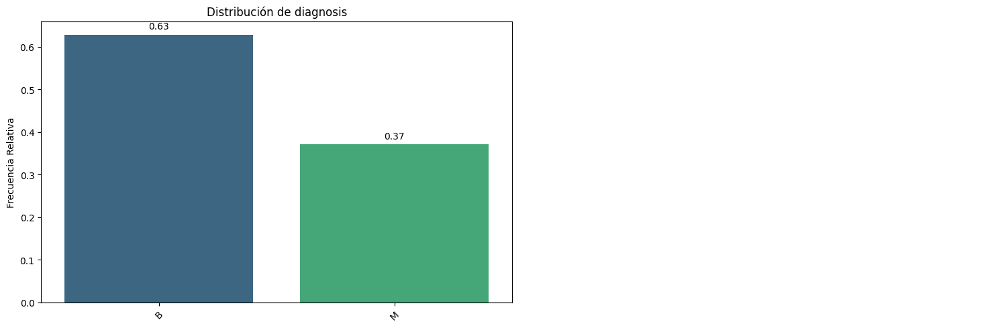

In [7]:
target = "diagnosis"
bt.pinta_distribucion_categoricas(train, [target], True, True)

### Ejercicio 4: MiniEDA (I) Análisis Visual

Realiza un análisis visual de las features y haz tu selección de primera "división" (que luego usaremos para comparar con otros métodos de selección).

In [8]:
sns.pairplot(train, hue=target)

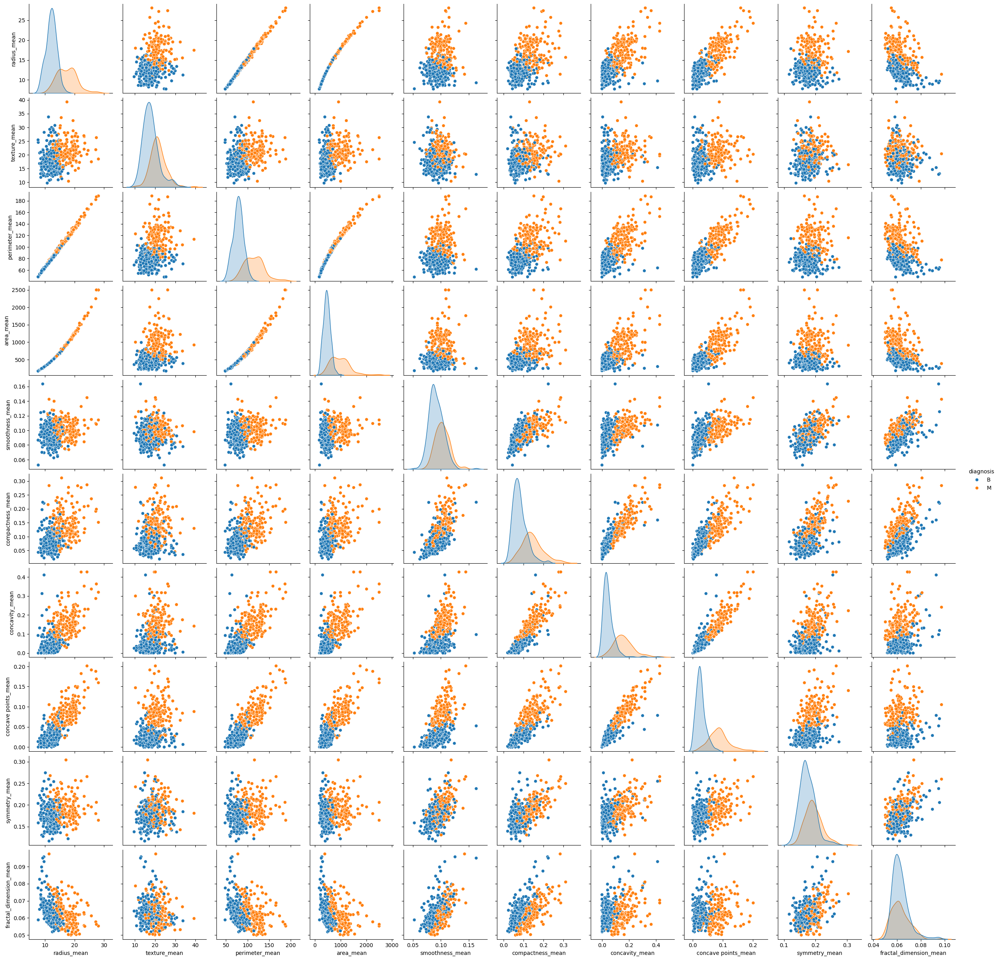

In [9]:
mean=train.columns[1:11].to_list() + [target]
sns.pairplot(train[mean], hue=target)

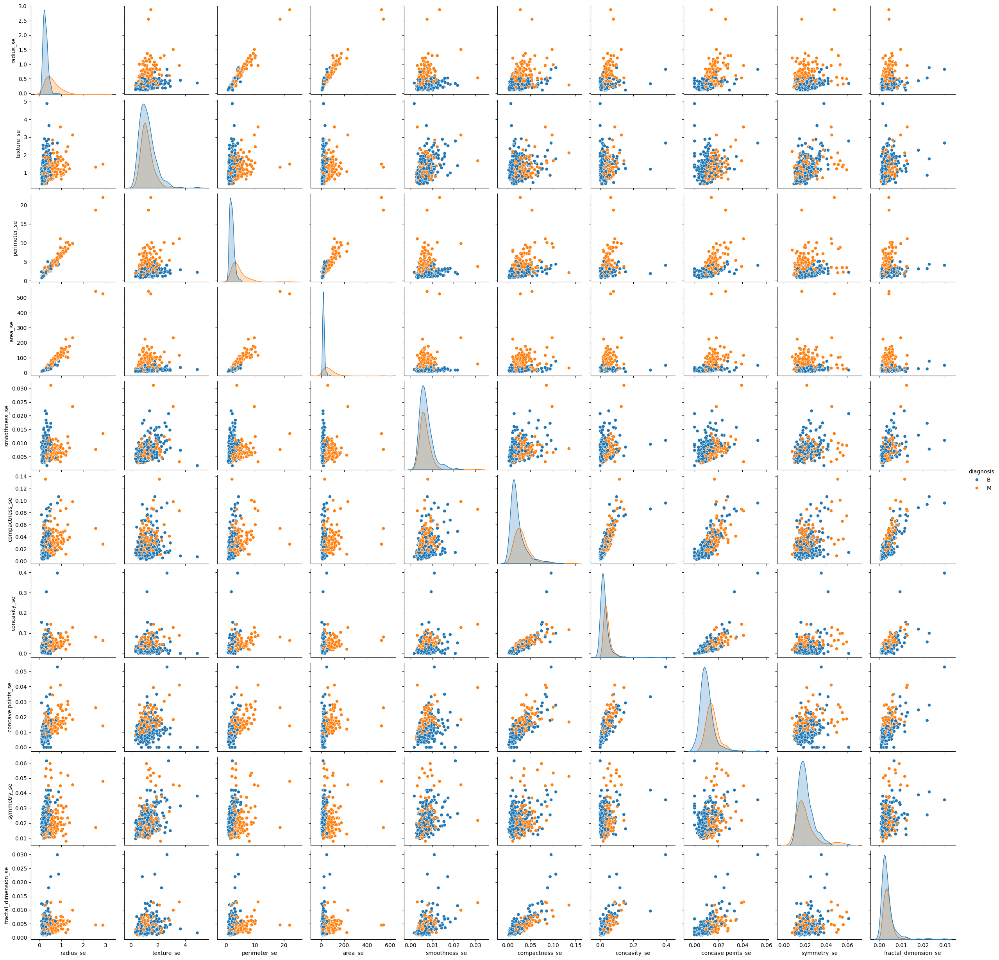

In [10]:
se=train.columns[11:21].to_list() + [target]
sns.pairplot(train[se], hue=target)

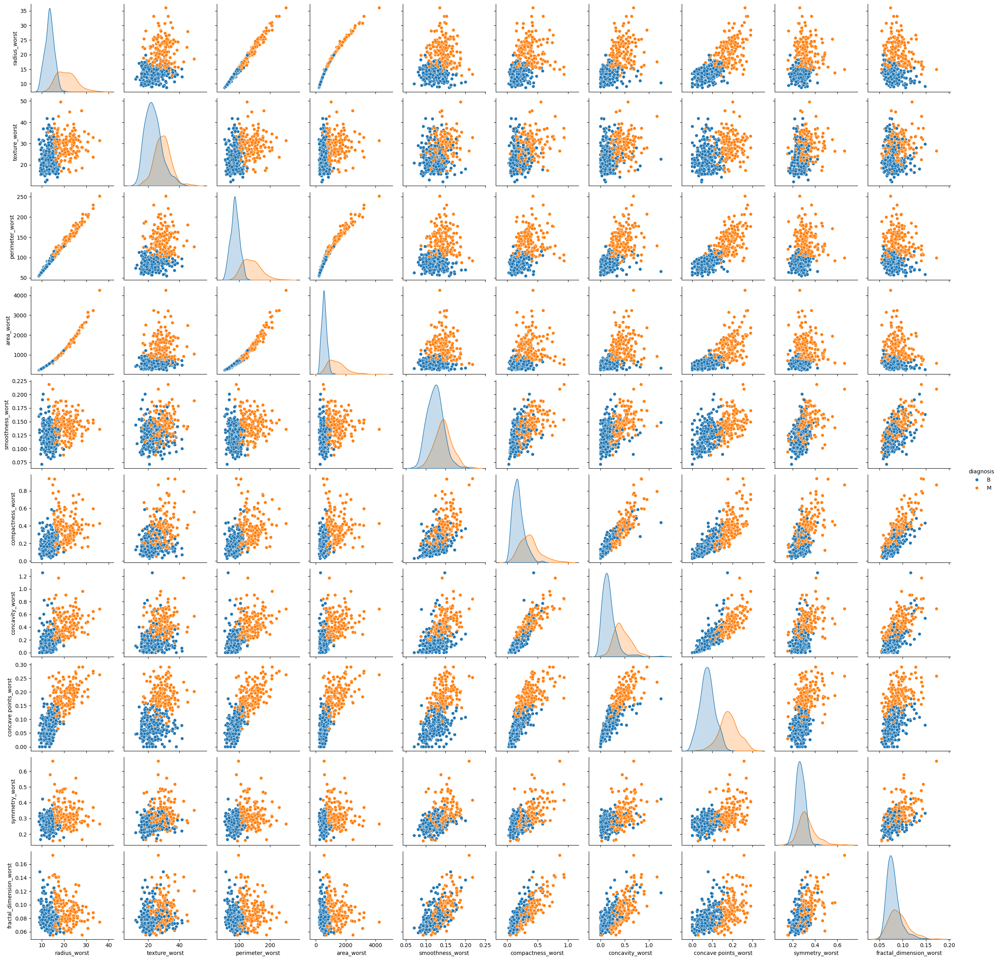

In [11]:
worst=train.columns[21:].to_list() + [target]
sns.pairplot(train[worst], hue=target)

In [12]:
primera = [

 
 'area_worst',

 'compactness_worst',
 'concavity_worst',
 'concave points_worst',
 'symmetry_worst',
 'fractal_dimension_worst',
]

### Ejercicio 5

Observa correlaciones entre las features. Utiliza un gráfico apropiado para ello. ¿Crees que sea posible eliminar algunas features para mejorar el modelo? (No hace falta que lo hagas ahora, lo haremos si es necesario en un ejercicio posterior)

<Axes: >

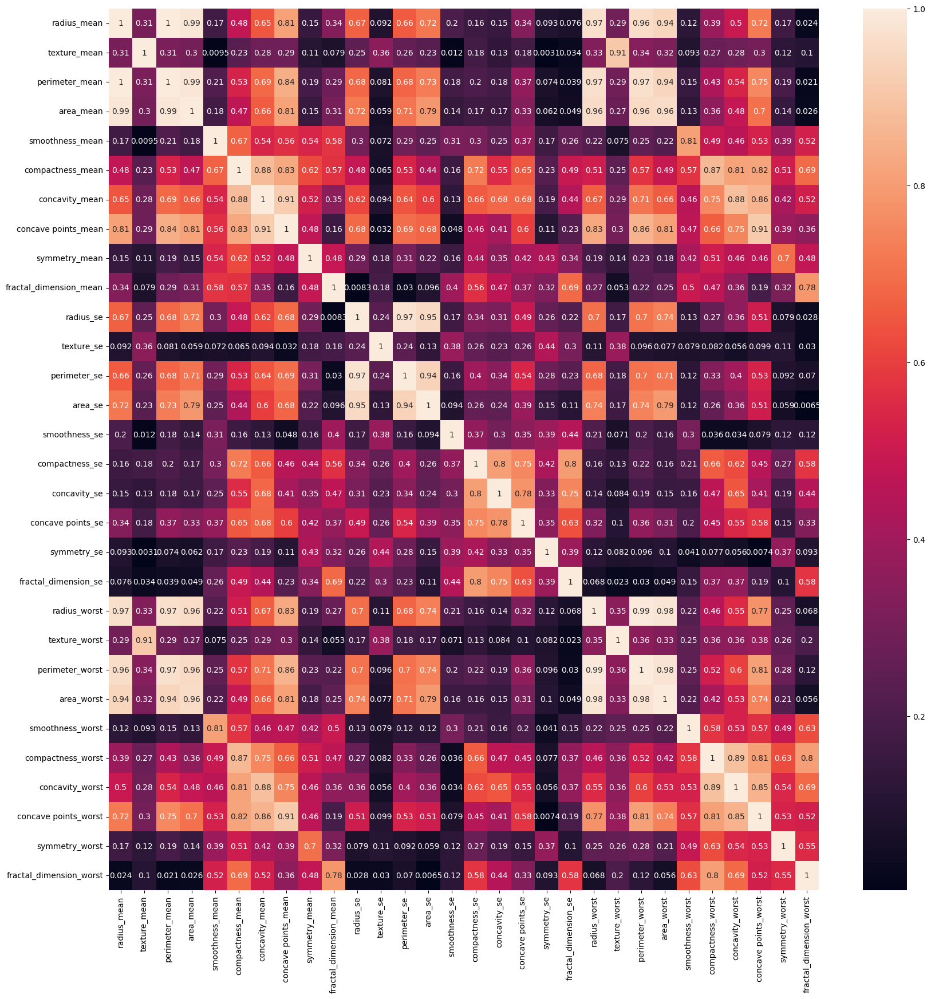

In [13]:
correlacion = train.corr(numeric_only=True)
plt.figure(figsize=(20,20))
sns.heatmap(abs(correlacion), annot=True)

### Ejercicio 6:

Entrena (con validación cruzada) un modelo de RandomForestClassifier (con max_depth a 5) con todas las features (ojo incluso las que descartamos en el ejercicio 4) y guarda el perfomance ("balanced_accuracy") en test en una variable. Será nuestro base line de comparación

In [14]:
X_train = train.drop(columns=[target])
y_train = train[target]

X_test = test.drop(columns=[target])
y_test = test[target]

In [16]:
rf = RandomForestClassifier(max_depth=5, random_state=42)
rf.fit(X_train, y_train)
cv_base = cross_val_score(rf, X_train, y_train, cv=5, scoring="balanced_accuracy").mean()
cv_base

0.9539121868843232

In [17]:
pred = rf.predict(X_test)
performance = balanced_accuracy_score(y_test, pred)
performance

0.9580740255486406

### Ejercicio 7

Vamos a emplear nuestras features del análisis visual pero descartando variables correladas entre sí (emplea la matriz ya obtenida en el ejercicio 5 o bien cualquier medio que creas conveniente). Descarta features y muestra la matriz de correlación para la selección final (recuerda, parte de la lista creada en el ejercicio 4)

<Axes: >

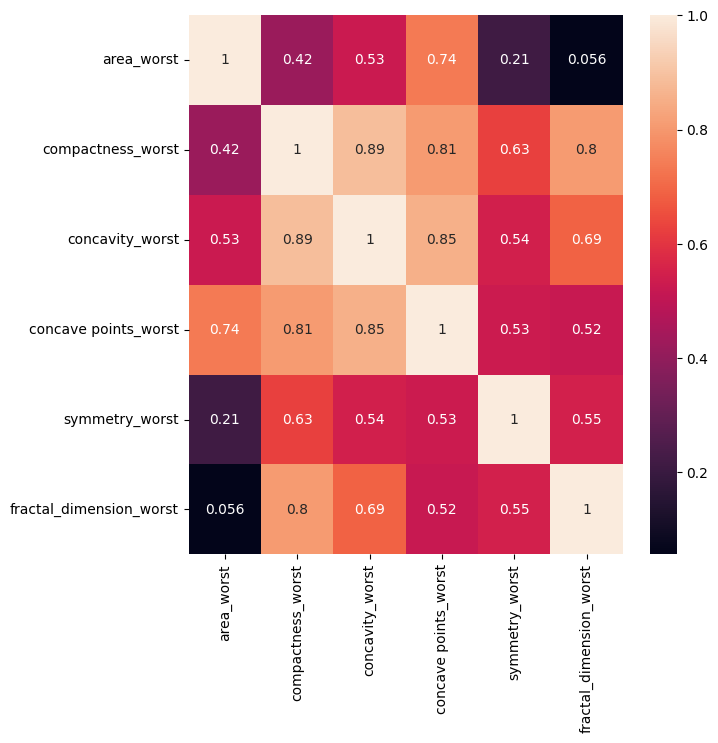

In [18]:
correlation = X_train[primera].corr(numeric_only=True)
plt.figure(figsize=(7,7))
sns.heatmap(correlation, annot=True)

In [19]:
primera.remove("concavity_worst")
primera.remove("compactness_worst")

<Axes: >

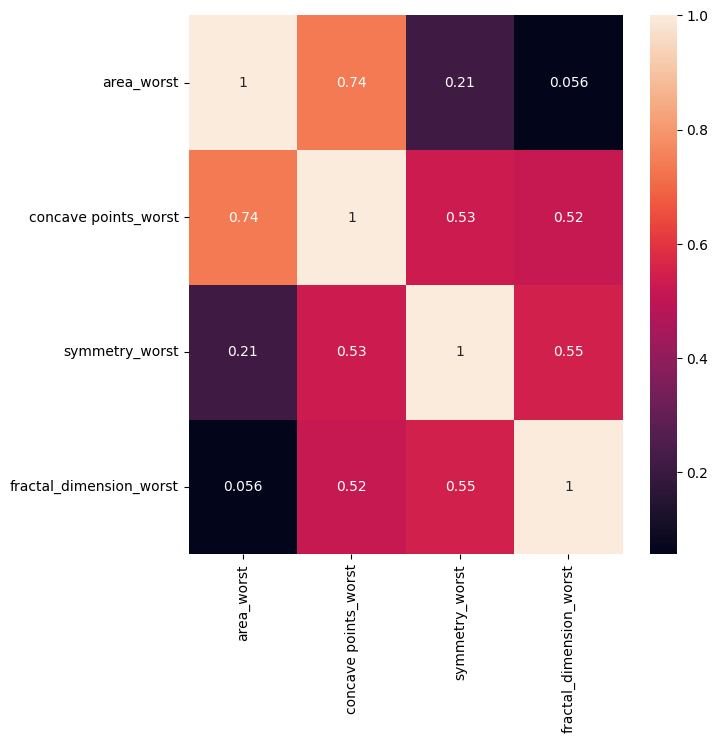

In [20]:
correlation = X_train[primera].corr(numeric_only=True)
plt.figure(figsize=(7,7))
sns.heatmap(correlation, annot=True)

### Ejercicio 8

Evalúa tu primer feature reduction. Entrena un modelo y evalúa su perfomance con los features que seleccionaste en el ejercicio anterios (emplea la validación cruzada)

In [21]:
cv_manual = cross_val_score(rf, X_train[primera], y_train, cv=5, scoring="balanced_accuracy").mean()
cv_manual

0.9410425381173753

### Ejercicio 9

Prueba ahora a hacer una feature selection utilizando ANOVA. Compara la validación cruzada con la del modelo baseline y con la del modelo anterior. (Pista: SelectKbest)

In [22]:
selector = SelectKBest(f_classif, k=5)
x_data_kbest = selector.fit_transform(X_train, y_train)

X_train_kbest = pd.DataFrame(x_data_kbest, columns = selector.get_feature_names_out())
X_train_kbest

,perimeter_mean,concave points_mean,radius_worst,perimeter_worst,concave points_worst
0,58.79,0.04375,10.310,65.50,0.17500
1,142.70,0.14960,26.680,176.50,0.29030
2,59.20,0.02180,10.010,65.59,0.05087
3,68.01,0.01615,12.250,77.98,0.06136
4,64.55,0.01290,11.020,69.86,0.02579
...,...,...,...,...,...
450,58.79,0.02872,9.733,62.56,0.04786
451,75.17,0.03485,13.140,85.51,0.12180
452,90.30,0.00625,14.910,94.44,0.03333
453,91.12,0.06463,17.040,113.90,0.18270


In [23]:
cv_kbest = cross_val_score(rf, X_train_kbest, y_train, cv=5, scoring="balanced_accuracy").mean()
cv_kbest

0.929897027281462

### Ejercicio 10

Prueba a hacer ahora una selección de features con RFE (Recursive Feature Elimination), hasta quedarte con 5 features. Evalúa perfomance en "balanced_accuracy" con cross_validation y compara con la baseline.

In [24]:
rfe = RFE(estimator = rf,
          n_features_to_select= 5, # Iterará hasta quedarse con 5
          step = 1) # Elimina de una en una, pero es configurable

rfe.fit(X_train, y_train)
print(rfe.ranking_)
rfe_features_df = pd.DataFrame(rfe.ranking_, 
                               columns= ["ranking"], 
                               index = X_train.columns).sort_values("ranking")
rfe_features_df

[ 7  5  6  8 14 16  2  1 26 24 12 22 23 13 19 20 15 25 18 17  1  3  1  1
  9 10  4  1 11 21]


,ranking
perimeter_worst,1
area_worst,1
radius_worst,1
concave points_mean,1
concave points_worst,1
concavity_mean,2
texture_worst,3
concavity_worst,4
texture_mean,5
perimeter_mean,6


In [25]:
rfe_features = rfe_features_df.iloc[:5].index.to_list()

In [26]:
cv_rfe = cross_val_score(rf, X_train[rfe_features], y_train, cv=5, scoring="balanced_accuracy").mean()
cv_rfe

0.9298667792475843

### Ejercicio 11

Prueba a eliminar features con el modelo de RandomForestClassifier (emplea SelectFromModel de sklearn). Utiliza esta vez una regresión logística para entrenar con las features escogidas y compara con el baseline. Muestra primero la importancia obtenida con el modelo baseline (que básicamente es el mismo que vamos a usar con SelectFromModel). Prueba primero para features por encima de la mediana y luego para las 5 primeras.

In [32]:
pd.DataFrame({"feature":X_train.columns,
              "importance":rf.feature_importances_}).sort_values(by="importance",ascending=False).head()

,feature,importance
23,area_worst,0.154737
27,concave points_worst,0.153030
7,concave points_mean,0.105276
20,radius_worst,0.075895
22,perimeter_worst,0.069279


In [38]:
selector_model = SelectFromModel(estimator = rf, threshold= "median") # El modelo debe tener un atributo feature_importances_ o un atributo coef_
selector_model.fit(X_train, y_train)

model_median_features = selector_model.get_feature_names_out()
model_5_features = model_median_features[:5]

In [39]:
log_reg = LogisticRegression(random_state=42)

In [40]:
cv_model_median = cross_val_score(log_reg, 
                                  X_train[model_median_features], 
                                  y_train, cv=5, 
                                  scoring="balanced_accuracy").mean()
cv_model_median

0.9372121988541334

In [41]:
cv_model_5 = cross_val_score(log_reg,
                             X_train[model_5_features],
                             y_train,
                             cv=5,
                             scoring="balanced_accuracy").mean()
cv_model_5

0.8639095664664149

### Ejercicio EXTRA:

Investiga RFECV y obten el número optimo de features siguiendo esta técnica pero con el "balanced_accuracy" como métrica.